# Imports

In [1]:
# handle math and data
import numpy as np
import pandas as pd
import time
import math

# to plot nice figures
%matplotlib inline
import matplotlib as mpl
import matplotlib.pyplot as plt
mpl.rc('axes', labelsize=14)
mpl.rc('xtick', labelsize=12)
mpl.rc('ytick', labelsize=12)

# handle files
import os
import sys
import joblib

# output
import tqdm

# deep learning
import tensorflow as tf
from tensorflow import keras
import tensorflow_datasets as tfds
import tensorflow_addons as tfa

# Setup

In [225]:
SEED = 69

K = keras.backend

AUTO = tf.data.AUTOTUNE

def reset_backend():
    K.clear_session()
    np.random.seed(SEED)
    tf.random.set_seed(SEED)

# Learning

In [3]:
def generate_time_series(batch_size, n_steps):
    freq1, freq2, offsets1, offsets2 = np.random.rand(4, batch_size, 1)
    time = np.linspace(0, 1, n_steps)
    series = 0.5 * np.sin((time - offsets1) * (freq1 * 10 + 10))  #   wave 1
    series += 0.2 * np.sin((time - offsets2) * (freq2 * 20 + 20)) # + wave 2
    series += 0.1 * (np.random.rand(batch_size, n_steps) - 0.5)   # + noise
    return series[..., np.newaxis].astype(np.float32)

In [216]:
sample = generate_time_series(2, 20)
sample.shape

(2, 20, 1)

In [217]:
sample

array([[[-0.26631618],
        [-0.3798956 ],
        [-0.35726923],
        [-0.08210501],
        [ 0.342781  ],
        [ 0.6233229 ],
        [ 0.43781146],
        [-0.10124397],
        [-0.56335086],
        [-0.6269537 ],
        [-0.1962609 ],
        [ 0.33380717],
        [ 0.6019114 ],
        [ 0.46000993],
        [-0.00693341],
        [-0.3254614 ],
        [-0.42745644],
        [-0.22445601],
        [-0.03708314],
        [ 0.14515562]],

       [[ 0.03480345],
        [-0.5617352 ],
        [-0.6222276 ],
        [ 0.1574598 ],
        [ 0.5758897 ],
        [ 0.35465264],
        [-0.07508422],
        [-0.19836237],
        [-0.3387464 ],
        [-0.2920939 ],
        [ 0.2915583 ],
        [ 0.7118441 ],
        [ 0.23491864],
        [-0.42585698],
        [-0.48632756],
        [-0.06227328],
        [ 0.16386366],
        [ 0.32281706],
        [ 0.3528586 ],
        [ 0.09433354]]], dtype=float32)

Generating data for an RNN that predict 10 time steps in the future at each time step, not just predicting the final 10 time steps based on the previous 50 steps.

In [6]:
np.random.seed(42)

n_steps = 50
series = generate_time_series(10000, n_steps + 10)
X_train = series[:7000, :n_steps]
X_valid = series[7000:9000, :n_steps]
X_test = series[9000:, :n_steps]

Generate the labels by setting each of the 10 future targets for all steps of all instances.
- Set all 50 target 0s to 1 to 50
- Set all 50 target 1s to 2 to 51
- ...
- Set all 50 target 8s to 9 to 58
- Set all 50 target 9s to 10 to 59

In [13]:
Y = np.empty((10000, n_steps, 10))
for step_ahead in range(1, 10 + 1):
    Y[..., step_ahead - 1] = series[..., step_ahead:step_ahead + n_steps, 0]
Y_train = Y[:7000]
Y_valid = Y[7000:9000]
Y_test = Y[9000:]

In [17]:
series.shape, X_train.shape, Y_train.shape

((10000, 60, 1), (7000, 50, 1), (7000, 50, 10))

# Classifier for SketchRNN

## Get Data

In [20]:
DOWNLOAD_ROOT = "http://download.tensorflow.org/data/"
FILENAME = "quickdraw_tutorial_dataset_v1.tar.gz"
filepath = keras.utils.get_file(FILENAME,
                                DOWNLOAD_ROOT + FILENAME,
                                cache_subdir="datasets/quickdraw",
                                extract=True)

1065301781/1065301781 [==============================] - 35s 0us/step


In [21]:
filepath

'/Users/calvinhuang/.keras/datasets/quickdraw/quickdraw_tutorial_dataset_v1.tar.gz'

In [30]:
from pathlib import Path

quickdraw_dir = Path(filepath).parent

In [31]:
quickdraw_dir

PosixPath('/Users/calvinhuang/.keras/datasets/quickdraw')

In [36]:
for path in quickdraw_dir.iterdir():
    print(path.name)

eval.tfrecord-00000-of-00010
eval.tfrecord-00001-of-00010
training.tfrecord-00009-of-00010
training.tfrecord-00008-of-00010
training.tfrecord-00003-of-00010
training.tfrecord-00002-of-00010
training.tfrecord-00004-of-00010
training.tfrecord-00005-of-00010
eval.tfrecord.classes
eval.tfrecord-00007-of-00010
eval.tfrecord-00006-of-00010
training.tfrecord-00000-of-00010
training.tfrecord-00001-of-00010
training.tfrecord.classes
eval.tfrecord-00003-of-00010
eval.tfrecord-00002-of-00010
eval.tfrecord-00009-of-00010
eval.tfrecord-00008-of-00010
eval.tfrecord-00004-of-00010
eval.tfrecord-00005-of-00010
training.tfrecord-00007-of-00010
training.tfrecord-00006-of-00010
quickdraw_tutorial_dataset_v1.tar.gz


Let's get the tfrecord files.

### Utility

Here we have tests, experiments, etc. and the end result is to create efficient tf datasets that load from the tfrecord files.

In [81]:
train_files = sorted([str(path) for path in quickdraw_dir.glob("training.tfrecord-*")])
test_files = sorted([str(path) for path in quickdraw_dir.glob("eval.tfrecord-*")])

In [82]:
train_files

['/Users/calvinhuang/.keras/datasets/quickdraw/training.tfrecord-00000-of-00010',
 '/Users/calvinhuang/.keras/datasets/quickdraw/training.tfrecord-00001-of-00010',
 '/Users/calvinhuang/.keras/datasets/quickdraw/training.tfrecord-00002-of-00010',
 '/Users/calvinhuang/.keras/datasets/quickdraw/training.tfrecord-00003-of-00010',
 '/Users/calvinhuang/.keras/datasets/quickdraw/training.tfrecord-00004-of-00010',
 '/Users/calvinhuang/.keras/datasets/quickdraw/training.tfrecord-00005-of-00010',
 '/Users/calvinhuang/.keras/datasets/quickdraw/training.tfrecord-00006-of-00010',
 '/Users/calvinhuang/.keras/datasets/quickdraw/training.tfrecord-00007-of-00010',
 '/Users/calvinhuang/.keras/datasets/quickdraw/training.tfrecord-00008-of-00010',
 '/Users/calvinhuang/.keras/datasets/quickdraw/training.tfrecord-00009-of-00010']

In [83]:
test_files

['/Users/calvinhuang/.keras/datasets/quickdraw/eval.tfrecord-00000-of-00010',
 '/Users/calvinhuang/.keras/datasets/quickdraw/eval.tfrecord-00001-of-00010',
 '/Users/calvinhuang/.keras/datasets/quickdraw/eval.tfrecord-00002-of-00010',
 '/Users/calvinhuang/.keras/datasets/quickdraw/eval.tfrecord-00003-of-00010',
 '/Users/calvinhuang/.keras/datasets/quickdraw/eval.tfrecord-00004-of-00010',
 '/Users/calvinhuang/.keras/datasets/quickdraw/eval.tfrecord-00005-of-00010',
 '/Users/calvinhuang/.keras/datasets/quickdraw/eval.tfrecord-00006-of-00010',
 '/Users/calvinhuang/.keras/datasets/quickdraw/eval.tfrecord-00007-of-00010',
 '/Users/calvinhuang/.keras/datasets/quickdraw/eval.tfrecord-00008-of-00010',
 '/Users/calvinhuang/.keras/datasets/quickdraw/eval.tfrecord-00009-of-00010']

In [58]:
next(iter(tf.data.TFRecordDataset(train_files[0])))

<tf.Tensor: shape=(), dtype=string, numpy=b'\n\xcc\x05\n\xa2\x05\n\x03ink\x12\x9a\x05\x12\x97\x05\n\x94\x05\x80B\xa1<\xa0\xb6P=\x00\x00\x00\x00\x10\x02\x01= r\x02=\x00\x00\x00\x00\xe8\xf3\xf9=\x80\xb6P\xbc\x00\x00\x00\x00 \x12\x89=\xa0\xb6P\xbd\x00\x00\x00\x00\x00\x02\x81\xbc\xda\xf7\x08\xbe\x00\x00\x00\x00\x90\xc3a\xbd\xcc\x9f6\xbe\x00\x00\x00\x00\x00\x83A\xbd\xcc\x9f6\xbd\x00\x00\x00\x00\xc0b1\xbd\xa0\xb6\xd0\xbb\x00\x00\x00\x00\xd0\xe3q\xbd\xa0\xb6P=\x00\x00\x00\x00\xe4r\xb9\xbd6\xabC>\x00\x00\x00\x00\x00\x02\x81\xbbp\xcd\xea=\x00\x00\x00\x00\x08\x83A=\xa8\xe2\xb9>\x00\x00\x00\x00\x80B!=\xa0\xb6P=\x00\x00\x00\x00\x90\xc3a=\x80\xb6P<\x00\x00\x00\x00\x88\xc3\xe1= r\x02\xbd\x00\x00\x00\x00@\xa3Q=\xd0\x9f6\xbd\x00\x00\x00\x00\x84B!>T<W\xbe\x00\x00\x00\x00\x08\x83\xc1=\x08\xc2\xdd\xbd\x00\x00\x00\x00\x00\x02\x81;(r\x82\xbd\x00\x00\x00\x00\xc0b1\xbd\xa0\xb6P\xbe\x00\x00\x00\x00\x90\xc3a\xbd\x8d}\x0f\xbe\x00\x00\x00\x00\x00\x02\x81\xbdb\x94\xa9\xbd\x00\x00\x00\x00(\x93I\xbet\xcd\xea\xbd\x0

Let's get the class names for train and test data.

In [69]:
with open(quickdraw_dir / "eval.tfrecord.classes") as test_classes_file:
    test_classes = test_classes_file.readlines()

with open(quickdraw_dir / "training.tfrecord.classes") as train_classes_file:
    train_classes = train_classes_file.readlines()

Let's make sure that the target classes are the same.

In [74]:
assert train_classes == test_classes

In [79]:
class_names = [name.strip().lower() for name in train_classes]
sorted(class_names)

['aircraft carrier',
 'airplane',
 'alarm clock',
 'ambulance',
 'angel',
 'animal migration',
 'ant',
 'anvil',
 'apple',
 'arm',
 'asparagus',
 'axe',
 'backpack',
 'banana',
 'bandage',
 'barn',
 'baseball',
 'baseball bat',
 'basket',
 'basketball',
 'bat',
 'bathtub',
 'beach',
 'bear',
 'beard',
 'bed',
 'bee',
 'belt',
 'bench',
 'bicycle',
 'binoculars',
 'bird',
 'birthday cake',
 'blackberry',
 'blueberry',
 'book',
 'boomerang',
 'bottlecap',
 'bowtie',
 'bracelet',
 'brain',
 'bread',
 'bridge',
 'broccoli',
 'broom',
 'bucket',
 'bulldozer',
 'bus',
 'bush',
 'butterfly',
 'cactus',
 'cake',
 'calculator',
 'calendar',
 'camel',
 'camera',
 'camouflage',
 'campfire',
 'candle',
 'cannon',
 'canoe',
 'car',
 'carrot',
 'castle',
 'cat',
 'ceiling fan',
 'cell phone',
 'cello',
 'chair',
 'chandelier',
 'church',
 'circle',
 'clarinet',
 'clock',
 'cloud',
 'coffee cup',
 'compass',
 'computer',
 'cookie',
 'cooler',
 'couch',
 'cow',
 'crab',
 'crayon',
 'crocodile',
 'crow

In [78]:
n_classes = len(class_names)
print(n_classes)

345


We need to parse the data now.

In [138]:
train_set_raw = tf.data.TFRecordDataset(train_files)
test_set_raw = tf.data.TFRecordDataset(test_files)

In [141]:
feature_descriptions = {
    "ink": tf.io.VarLenFeature(dtype=tf.float32),
    "shape": tf.io.FixedLenFeature([2], dtype=tf.int64),
    "class_index": tf.io.FixedLenFeature([1], dtype=tf.int64)
}

for proto in test_set_raw.take(1):
    quickdraw_sample = tf.io.parse_single_example(proto, feature_descriptions)

In [142]:
quickdraw_sample

{'ink': <tensorflow.python.framework.sparse_tensor.SparseTensor at 0x7fca518f2e60>,
 'class_index': <tf.Tensor: shape=(1,), dtype=int64, numpy=array([51])>,
 'shape': <tf.Tensor: shape=(2,), dtype=int64, numpy=array([33,  3])>}

Let's make a function to parse the serialized protobufs.

In [223]:
# takes a bytestring and returns a dict like the sample above
def parse_fn(serialized_batch):
    # parse batch
    feature_descriptions = {
        "ink": tf.io.VarLenFeature(dtype=tf.float32),
        "shape": tf.io.FixedLenFeature([2], dtype=tf.int64),
        "class_index": tf.io.FixedLenFeature([1], dtype=tf.int64)
    }
    batch = tf.io.parse_example(serialized_batch, feature_descriptions)
    
    # convert ink sparse tensors to dense, result is shape (batch_size, max ink length)
    flat_sketches = tf.sparse.to_dense(batch["ink"])
    # convert flat sketch tensors to sequence shape
    sketches = tf.reshape(flat_sketches, shape=[tf.size(serialized_batch), -1, 3])
    
    # get lengths of sequences
    lengths = batch["shape"][:, 0]
    
    # get labels
    labels = batch["class_index"][:, 0]
    
    return sketches, lengths, labels

In [224]:
for batch in train_set_raw.batch(32).take(1):
    parsed_batch = parse_fn(batch)
parsed_batch

(<tf.Tensor: shape=(32, 67, 3), dtype=float32, numpy=
 array([[[ 0.01968503,  0.05095541,  0.        ],
         [ 0.03149611,  0.03184712,  0.        ],
         [ 0.12204725, -0.01273882,  0.        ],
         ...,
         [ 0.        ,  0.        ,  0.        ],
         [ 0.        ,  0.        ,  0.        ],
         [ 0.        ,  0.        ,  0.        ]],
 
        [[-0.03149606,  0.        ,  0.        ],
         [-0.04724409,  0.04347825,  0.        ],
         [ 0.00393701,  0.06211179,  0.        ],
         ...,
         [ 0.        ,  0.        ,  0.        ],
         [ 0.        ,  0.        ,  0.        ],
         [ 0.        ,  0.        ,  0.        ]],
 
        [[ 0.31889763, -0.22222221,  0.        ],
         [ 0.12204725, -0.10582012,  0.        ],
         [ 0.07874015, -0.04761904,  0.        ],
         ...,
         [ 0.        ,  0.        ,  0.        ],
         [ 0.        ,  0.        ,  0.        ],
         [ 0.        ,  0.        ,  0.        ]

Now let's create our dataset objects, use a helper function.

### Create Datasets

In [234]:
def quickdraw_dataset(filenames,
                      shuffle_buffer_size=None,
                      batch_size=32, 
                      n_read_threads=AUTO, 
                      n_parse_threads=AUTO,
                      cache=False):
    dataset = tf.data.TFRecordDataset(filenames, num_parallel_reads=n_read_threads)
    if cache:
        dataset = dataset.cache()
    if shuffle_buffer_size:
        dataset = dataset.shuffle(shuffle_buffer_size)
    dataset = dataset.batch(batch_size)
    dataset = dataset.map(parse_fn, num_parallel_calls=n_parse_threads)
    return dataset.prefetch(1)

In [236]:
train_set = quickdraw_dataset(train_files, shuffle_buffer_size=10000)
valid_set = quickdraw_dataset(test_files[:5])
test_set = quickdraw_dataset(test_files[5:])

We get a triple-tuple of:
- sketch vector sequences 
    - (batch_size, max sequence length of all sequences in batch, vector values and stroke indication aka inputs per step - padded with zeros)
- sequence lengths
    - length of sequence or num_steps for each sequence in the batch (since they differ from seq to seq)
- class indices
    - the index of the class or target that each sequence belongs to

In [239]:
for batch in train_set.take(1):
    print(batch)

(<tf.Tensor: shape=(32, 75, 3), dtype=float32, numpy=
array([[[-0.07070708,  0.59607846,  0.        ],
        [-0.06565657,  0.36470586,  0.        ],
        [ 0.0959596 ,  0.01568627,  0.        ],
        ...,
        [ 0.        ,  0.        ,  0.        ],
        [ 0.        ,  0.        ,  0.        ],
        [ 0.        ,  0.        ,  0.        ]],

       [[-0.10196079,  0.17156863,  0.        ],
        [-0.04705882,  0.17156863,  0.        ],
        [ 0.        ,  0.09803924,  0.        ],
        ...,
        [ 0.        ,  0.        ,  0.        ],
        [ 0.        ,  0.        ,  0.        ],
        [ 0.        ,  0.        ,  0.        ]],

       [[ 0.7045455 , -0.00787402,  0.        ],
        [ 0.06818181,  0.01574803,  0.        ],
        [ 0.01136363,  0.04724409,  0.        ],
        ...,
        [ 0.        ,  0.        ,  0.        ],
        [ 0.        ,  0.        ,  0.        ],
        [ 0.        ,  0.        ,  0.        ]],

       ...,

      

### Visualize

Let's visualize these sketches. Each step in the sequence is a vector that starts from the previous vector. So the coordinates can be calculated with a cumulative sum of all previous vectors starting at the origin.

In [264]:
sample_batch = next(iter(valid_set.take(1)))

# Get the first sample's sequence without padded zeros, and its class index
ix = 0
sample_sketch, sample_label = sample_batch[0][ix], sample_batch[2][ix]

In [283]:
def draw_sketch(sketch, label=None):
    # origin to start off the sketch's vectors
    origin = np.array([[0., 0., 0.]])
    sketch = np.r_[origin, sketch]
    
    # strokes ends are when the third column is a 1
    stroke_end_indices = np.argwhere(sketch[:, -1]==1.)[:, 0]
    
    # Since each row in sketch[:, :2] is a vector starting from the previous row
    # The image's actual coordinates are the cumulative sum of all previous rows (aka vectors)
    # starting from the origin.
    coordinates = np.cumsum(sketch[:, :2], axis=0)
    
    # splits coordinates by indices
    # add one because you want to include the stroke end in it's stroke, not the next stroke
    strokes = np.split(coordinates, stroke_end_indices + 1)

    # plot
    title = class_names[label.numpy()] if label is not None else "Try to guess"
    plt.title(title)
    # flip vertically
    plt.plot(coordinates[:, 0], -coordinates[:, 1], "y:")
    for stroke in strokes:
        plt.plot(stroke[:, 0], -stroke[:, 1], ".-")
    plt.axis("off")

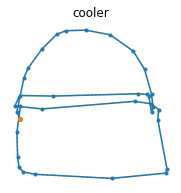

In [284]:
plt.figure(figsize=(3,3))
draw_sketch(sample_sketch, label=sample_label)

In [285]:
def draw_sketches(sketches, lengths, labels):
    n_sketches = len(sketches)
    n_cols = 4
    # account for partially occupied rows without adding a row if perfectly occupied
    n_rows = (n_sketches - 1) // n_cols + 1
    plt.figure(figsize=(n_cols * 3, n_rows * 3.5))
    for index, sketch, length, label in zip(range(n_sketches), sketches, lengths, labels):
        plt.subplot(n_rows, n_cols, index + 1)
        draw_sketch(sketch[:length], label)
    plt.show()

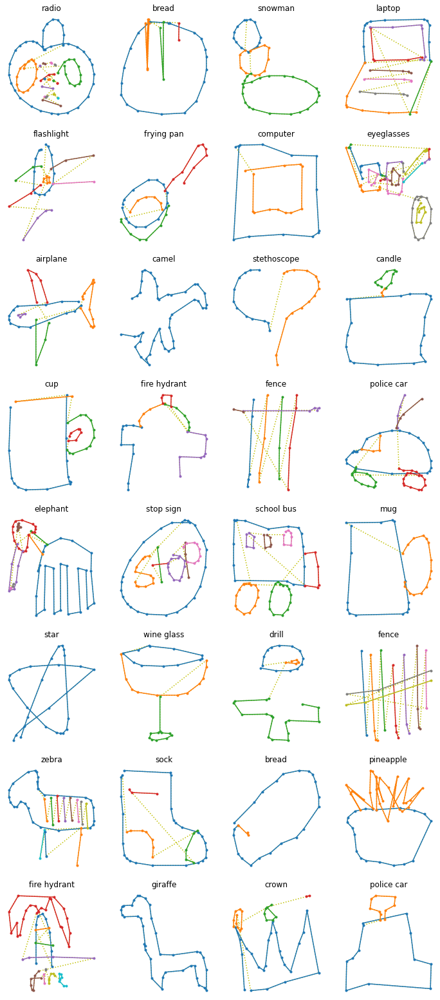

In [286]:
for sketches, lengths, labels in train_set.take(1):
    draw_sketches(sketches, lengths, labels)

### Explore Data

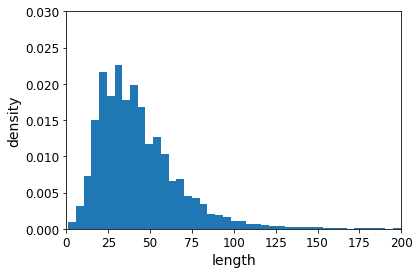

In [299]:
lengths = np.concatenate([lengths for _, lengths, _ in train_set.take(1000)])
plt.hist(lengths, bins=150, density=True)
plt.axis([0, 200, 0, 0.03])
plt.xlabel("length")
plt.ylabel("density")
plt.show()

In [300]:
# crops all sketch sequences to a max_length of 100, also gets rid of length and 
# returns tuple (input seq, labels)
def crop_long_sketches(dataset, max_length=100):
    return dataset.map(lambda inks, lengths, labels: (inks[:, :max_length], labels))

cropped_train_set = crop_long_sketches(train_set)
cropped_valid_set = crop_long_sketches(valid_set)
cropped_test_set = crop_long_sketches(test_set)

## Train RNN

Now that we have the datasets, let's train a simple RNN.

In [301]:
n_classes

345

In [304]:
reset_backend()

model = keras.models.Sequential([
    keras.layers.SimpleRNN(20, return_sequences=True, activation="tanh",
                           input_shape=[None, 3]),
    keras.layers.SimpleRNN(20),
    keras.layers.Dense(n_classes, activation="softmax")
])

model.compile(loss="sparse_categorical_crossentropy",
              optimizer="nadam",
              metrics=["accuracy"])

model.fit(cropped_train_set, epochs=1,
          steps_per_epoch=1000,
          validation_data=cropped_valid_set,
          validation_steps=1000)

1000/1000 [==============================] - 25s 24ms/step - loss: 5.8356 - accuracy: 0.0039 - val_loss: 5.8334 - val_accuracy: 0.0038


Since the sequence can go up to 100 steps, we need to defend against unstable gradients and short-term memory loss.

Try using layer normalization.
- The required arguments for a custom cell can be seen in the **[documentation](https://www.tensorflow.org/api_docs/python/tf/keras/layers/RNN)**

In [305]:
class LNSimpleRNNCell(keras.layers.Layer):
    def __init__(self, units, activation="tanh", **kwargs):
        super().__init__(**kwargs)
        self.state_size = units
        self.output_size = units
        self.simple_rnn_cell = keras.layers.SimpleRNNCell(units,
                                                          activation=None)
        self.layer_norm = keras.layers.LayerNormalization()
        self.activation = keras.activations.get(activation)
        
    def call(self, inputs, states):
        outputs, new_states = self.simple_rnn_cell(inputs, states)
        norm_outputs = self.activation(self.layer_norm(outputs))
        return norm_outputs, [norm_outputs]

Now let's train the model again, but with layer normalization.

In [306]:
reset_backend()

model = keras.models.Sequential([
    keras.layers.RNN(LNSimpleRNNCell(20), return_sequences=True,
                           input_shape=[None, 3]),
    keras.layers.RNN(LNSimpleRNNCell(20)),
    keras.layers.Dense(n_classes, activation="softmax")
])

model.compile(loss="sparse_categorical_crossentropy",
              optimizer="nadam",
              metrics=["accuracy"])

model.fit(cropped_train_set, epochs=1,
          steps_per_epoch=1000,
          validation_data=cropped_valid_set,
          validation_steps=1000)

1000/1000 [==============================] - 52s 50ms/step - loss: 5.8364 - accuracy: 0.0038 - val_loss: 5.8007 - val_accuracy: 0.0051


We also need to account for short-term memory loss. Let's use GRU layers.

In [307]:
class LNGRUCell(keras.layers.Layer):
    def __init__(self, units, activation="tanh", **kwargs):
        super().__init__(**kwargs)
        self.state_size = units
        self.output_size = units
        self.gru_cell = keras.layers.GRUCell(units,
                                                    activation=None)
        self.layer_norm = keras.layers.LayerNormalization()
        self.activation = keras.activations.get(activation)
        
    def call(self, inputs, states):
        outputs, new_states = self.gru_cell(inputs, states)
        norm_outputs = self.activation(self.layer_norm(outputs))
        return norm_outputs, [new_states]

In [308]:
reset_backend()

model = keras.models.Sequential([
    keras.layers.RNN(LNGRUCell(20), return_sequences=True,
                           input_shape=[None, 3]),
    keras.layers.RNN(LNGRUCell(20)),
    keras.layers.Dense(n_classes, activation="softmax")
])

model.compile(loss="sparse_categorical_crossentropy",
              optimizer="nadam",
              metrics=["accuracy"])

model.fit(cropped_train_set, epochs=1,
          steps_per_epoch=1000,
          validation_data=cropped_valid_set,
          validation_steps=1000)

1000/1000 [==============================] - 74s 71ms/step - loss: 5.7818 - accuracy: 0.0045 - val_loss: 5.6293 - val_accuracy: 0.0072


The minor accuracy improvement does show one thing - that we need to learn more general patterns. This makes sense as the specific line vectors actually do not hold much info, it is the groups and patterns in the overall image that we nee to learn.

Let's add dilution with 1D conv layers and use GRU with recurrent dropout instead of layer normalization.

### Model Architecture

In [311]:
reset_backend()

model = keras.models.Sequential([
    keras.layers.Conv1D(16, kernel_size=2, strides=2, padding="valid"),
    keras.layers.Conv1D(32, kernel_size=2, strides=2, padding="valid"),
    keras.layers.Conv1D(64, kernel_size=2, strides=2, padding="valid"),
    keras.layers.BatchNormalization(),
    keras.layers.GRU(64, activation="tanh", return_sequences=True),
    keras.layers.GRU(64, activation="tanh"),
    keras.layers.Dense(n_classes, activation="softmax")
])

model.compile(loss="sparse_categorical_crossentropy",
              optimizer="nadam",
              metrics=["accuracy"])

model.fit(cropped_train_set, epochs=1,
          validation_data=cropped_valid_set)

107813/107813 [==============================] - 1109s 10ms/step - loss: 3.0991 - accuracy: 0.3118 - val_loss: 2.6490 - val_accuracy: 0.3875


In [312]:
y_test = np.concatenate([labels for _, _, labels in test_set])
y_probas = model.predict(test_set)

5392/5392 [==============================] - 19s 3ms/step


In [313]:
np.mean(keras.metrics.sparse_top_k_categorical_accuracy(y_test, y_probas))

0.6180446

### Visualize Predictions

Let's visualize the sketch for an instance and print the model's top 5 predictions for it.

In [321]:
for sketches, labels in cropped_train_set.take(1):
    pass

In [322]:
n_new = 10
Y_probas = model.predict(sketches)
top_k = tf.nn.top_k(Y_probas, k=5)

1/1 [==============================] - 1s 652ms/step


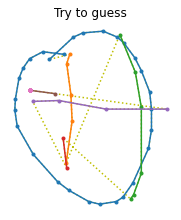

Top-5 predictions:
  1. basketball 51.553%
  2. wheel 23.431%
  3. baseball 4.510%
  4. brain 3.084%
  5. tennis racquet 3.081%
Answer: baseball


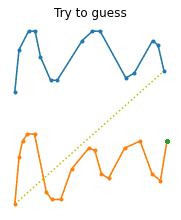

Top-5 predictions:
  1. ocean 34.325%
  2. squiggle 8.108%
  3. river 7.096%
  4. zigzag 5.711%
  5. saw 4.874%
Answer: river


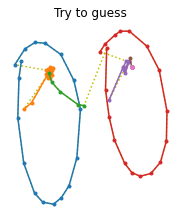

Top-5 predictions:
  1. flip flops 17.460%
  2. bottlecap 6.079%
  3. garden hose 4.498%
  4. bracelet 4.432%
  5. blueberry 3.711%
Answer: flip flops


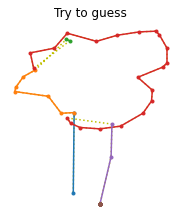

Top-5 predictions:
  1. tree 52.970%
  2. broccoli 11.363%
  3. hammer 8.235%
  4. fire hydrant 6.034%
  5. flamingo 4.655%
Answer: tree


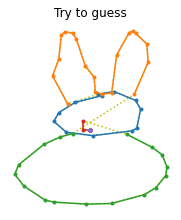

Top-5 predictions:
  1. rabbit 68.386%
  2. snowman 16.995%
  3. toilet 5.031%
  4. flying saucer 1.678%
  5. swan 0.818%
Answer: rabbit


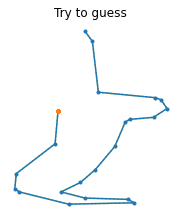

Top-5 predictions:
  1. lightning 63.609%
  2. wine glass 10.105%
  3. knee 6.250%
  4. shovel 4.139%
  5. elbow 3.730%
Answer: knee


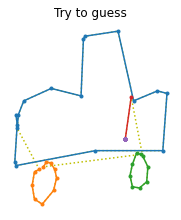

Top-5 predictions:
  1. truck 27.358%
  2. pickup truck 19.658%
  3. car 12.185%
  4. police car 7.251%
  5. rollerskates 7.059%
Answer: pickup truck


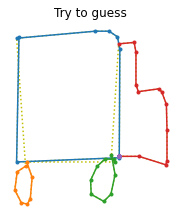

Top-5 predictions:
  1. truck 35.624%
  2. rollerskates 13.123%
  3. pickup truck 8.809%
  4. scissors 5.615%
  5. tractor 3.952%
Answer: truck


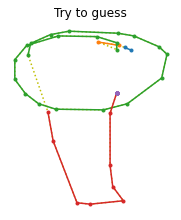

Top-5 predictions:
  1. microphone 21.786%
  2. lollipop 11.330%
  3. mushroom 8.771%
  4. hockey puck 4.066%
  5. spoon 3.017%
Answer: microphone


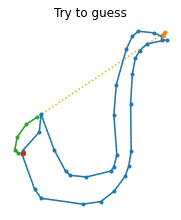

Top-5 predictions:
  1. saxophone 91.549%
  2. swan 4.737%
  3. snake 1.184%
  4. sock 0.347%
  5. duck 0.292%
Answer: saxophone


In [323]:
for index in range(n_new):
    plt.figure(figsize=(3, 3.5))
    draw_sketch(sketches[index])
    plt.show()
    print("Top-5 predictions:".format(index + 1))
    for k in range(5):
        class_name = class_names[top_k.indices[index, k]]
        proba = 100 * top_k.values[index, k]
        print("  {}. {} {:.3f}%".format(k + 1, class_name, proba))
    print("Answer: {}".format(class_names[labels[index].numpy()]))

### Train Final Model

Now let's add callbacks, run this for many epochs, and add some dropout.

In [324]:
TENSORBOARD_DIR = os.path.join(".", "_tf_logs", "14_rnn")
os.makedirs(TENSORBOARD_DIR, exist_ok=True)

In [325]:
run_index = 1
run_logdir = os.path.join(TENSORBOARD_DIR, "model_1_run_{:05d}".format(run_index))
tensorboard_cb = keras.callbacks.TensorBoard(log_dir=run_logdir)
print(run_logdir)

./_tf_logs/14_rnn/model_1_run_00001


In [ ]:
reset_backend()

model = keras.models.Sequential([
    keras.layers.Conv1D(16, kernel_size=2, strides=2, padding="valid"),
    keras.layers.Conv1D(32, kernel_size=2, strides=2, padding="valid"),
    keras.layers.Conv1D(64, kernel_size=2, strides=2, padding="valid"),
    keras.layers.BatchNormalization(),
    keras.layers.GRU(64, activation="tanh", return_sequences=True, recurrent_dropout=0.1),
    keras.layers.GRU(64, activation="tanh"),
    keras.layers.Dense(n_classes, activation="softmax")
])

model.compile(loss="sparse_categorical_crossentropy",
              optimizer="nadam",
              metrics=["accuracy", "sparse_top_k_categorical_accuracy"])

# Callbacks
early_stopping_cb = keras.callbacks.EarlyStopping(patience=4)
lr_scheduler_cb = keras.callbacks.ReduceLROnPlateau(factor=0.1, patience=2)

model.fit(cropped_train_set, epochs=10,
          validation_data=cropped_valid_set,
          callbacks=[tensorboard_cb, early_stopping_cb, lr_scheduler_cb])

1/1 [==============================] - 1s 656ms/step


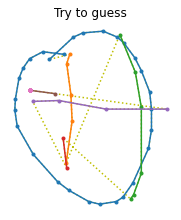

Top-5 predictions:
  1. basketball 57.677%
  2. baseball 18.126%
  3. wheel 15.746%
  4. pizza 2.547%
  5. onion 0.903%
Answer: baseball


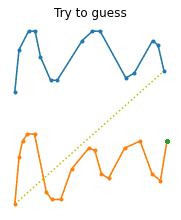

Top-5 predictions:
  1. ocean 68.763%
  2. the great wall of china 12.866%
  3. river 7.154%
  4. animal migration 2.642%
  5. moustache 1.828%
Answer: river


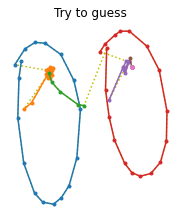

Top-5 predictions:
  1. flip flops 60.959%
  2. cup 6.273%
  3. saxophone 3.587%
  4. teapot 2.653%
  5. coffee cup 2.503%
Answer: flip flops


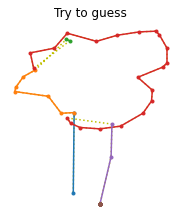

Top-5 predictions:
  1. tree 34.467%
  2. mushroom 20.161%
  3. umbrella 9.250%
  4. broccoli 5.888%
  5. mailbox 5.098%
Answer: tree


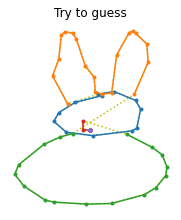

Top-5 predictions:
  1. rabbit 78.606%
  2. sink 2.422%
  3. house plant 1.992%
  4. toilet 1.609%
  5. wristwatch 1.118%
Answer: rabbit


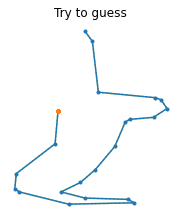

Top-5 predictions:
  1. lightning 40.451%
  2. wine glass 16.764%
  3. hourglass 9.488%
  4. shovel 6.504%
  5. knee 4.105%
Answer: knee


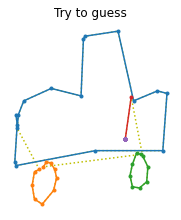

Top-5 predictions:
  1. truck 24.512%
  2. pickup truck 21.399%
  3. firetruck 11.279%
  4. ambulance 10.379%
  5. van 10.134%
Answer: pickup truck


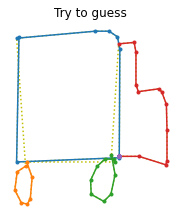

Top-5 predictions:
  1. truck 58.918%
  2. firetruck 13.281%
  3. pickup truck 5.969%
  4. ambulance 4.356%
  5. van 3.615%
Answer: truck


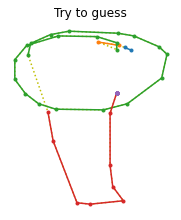

Top-5 predictions:
  1. mushroom 38.676%
  2. microphone 14.121%
  3. lollipop 9.822%
  4. ice cream 5.542%
  5. wristwatch 3.521%
Answer: microphone


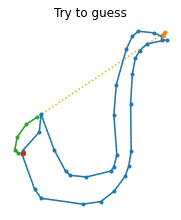

Top-5 predictions:
  1. saxophone 96.734%
  2. swan 0.934%
  3. snake 0.640%
  4. telephone 0.256%
  5. snorkel 0.217%
Answer: saxophone


In [327]:
n_new = 10
Y_probas = model.predict(sketches)
top_k = tf.nn.top_k(Y_probas, k=5)
for index in range(n_new):
    plt.figure(figsize=(3, 3.5))
    draw_sketch(sketches[index])
    plt.show()
    print("Top-5 predictions:".format(index + 1))
    for k in range(5):
        class_name = class_names[top_k.indices[index, k]]
        proba = 100 * top_k.values[index, k]
        print("  {}. {} {:.3f}%".format(k + 1, class_name, proba))
    print("Answer: {}".format(class_names[labels[index].numpy()]))

# Generate Bach Chorales

Our goal is to create a model using RNNs or CNNs or both that can generate the next step to a sequence of chorales in Bach-like fashion.

## Get Data

Let's first download the Bach chorales data.

In [328]:
DOWNLOAD_ROOT = "https://github.com/ageron/handson-ml2/raw/master/datasets/jsb_chorales/"
FILENAME = "jsb_chorales.tgz"
filepath = keras.utils.get_file(FILENAME,
                                DOWNLOAD_ROOT + FILENAME,
                                cache_subdir="datasets/jsb_chorales",
                                extract=True)

117661/117661 [==============================] - 0s 1us/step


In [333]:
chorales_dir = Path(filepath).parent

In [345]:
chorales_dir.parts

('/', 'Users', 'calvinhuang', '.keras', 'datasets', 'jsb_chorales')

Let's peek at the folders and file structure.

In [344]:
def peek_path_files(path):
    for name, subdirs, files in os.walk(path):
        indent = len(Path(name).parts) - len(path.parts)
        print("    " * indent + Path(name).parts[-1] + os.sep)
        for index, filename in enumerate(sorted(files)):
            if index == 3:
                print("    " * (indent + 1) + "...")
                break
            print("    " * (indent + 1) + filename)

peek_path_files(chorales_dir)

jsb_chorales/
    jsb_chorales.tgz
    valid/
        chorale_229.csv
        chorale_230.csv
        chorale_231.csv
        ...
    test/
        chorale_305.csv
        chorale_306.csv
        chorale_307.csv
        ...
    train/
        chorale_000.csv
        chorale_001.csv
        chorale_002.csv
        ...


Let's load the csv data with pandas and just see how it looks.

In [346]:
sample = pd.read_csv(chorales_dir / "train" / "chorale_000.csv")

In [348]:
sample

,note0,note1,note2,note3
0,74,70,65,58
1,74,70,65,58
2,74,70,65,58
3,74,70,65,58
4,75,70,58,55
...,...,...,...,...
187,70,65,62,46
188,70,65,62,46
189,70,65,62,46
190,70,65,62,46


Let's get all the filepaths for train, valid, and test.

In [355]:
train_files = sorted([str(path) for path in (chorales_dir / "train").glob("*.csv")])
valid_files = sorted([str(path) for path in (chorales_dir / "valid").glob("*.csv")])
test_files = sorted([str(path) for path in (chorales_dir / "test").glob("*.csv")])

Let's create a dataset in memory first (we can store and load from tfrecords later).

In [396]:
def load_chorales(filepaths):
    return [pd.read_csv(filepath).values.tolist() for filepath in filepaths]

train_chorales = load_chorales(train_files)
valid_chorales = load_chorales(valid_files)
test_chorales = load_chorales(test_files)

In [409]:
sample_chorales = train_chorales[:3]

Check if assumption about notes is correct.

In [399]:
notes = set()
for chorales in (train_chorales, valid_chorales, test_chorales):
    for chorale in chorales:
        for chord in chorale:
            # get all unique notes
            notes |= set(chord)

n_notes = len(notes)
min_note = min(notes - {0})
max_note = max(notes)

assert min_note == 36
assert max_note == 81

Play sounds! Referenced from Ageron.

In [400]:
from IPython.display import Audio

def notes_to_frequencies(notes):
    # Frequency doubles when you go up one octave; there are 12 semi-tones
    # per octave; Note A on octave 4 is 440 Hz, and it is note number 69.
    return 2 ** ((np.array(notes) - 69) / 12) * 440

def frequencies_to_samples(frequencies, tempo, sample_rate):
    note_duration = 60 / tempo # the tempo is measured in beats per minutes
    # To reduce click sound at every beat, we round the frequencies to try to
    # get the samples close to zero at the end of each note.
    frequencies = np.round(note_duration * frequencies) / note_duration
    n_samples = int(note_duration * sample_rate)
    time = np.linspace(0, note_duration, n_samples)
    sine_waves = np.sin(2 * np.pi * frequencies.reshape(-1, 1) * time)
    # Removing all notes with frequencies ≤ 9 Hz (includes note 0 = silence)
    sine_waves *= (frequencies > 9.).reshape(-1, 1)
    return sine_waves.reshape(-1)

def chords_to_samples(chords, tempo, sample_rate):
    freqs = notes_to_frequencies(chords)
    freqs = np.r_[freqs, freqs[-1:]] # make last note a bit longer
    merged = np.mean([frequencies_to_samples(melody, tempo, sample_rate)
                     for melody in freqs.T], axis=0)
    n_fade_out_samples = sample_rate * 60 // tempo # fade out last note
    fade_out = np.linspace(1., 0., n_fade_out_samples)**2
    merged[-n_fade_out_samples:] *= fade_out
    return merged

def play_chords(chords, tempo=160, amplitude=0.1, sample_rate=44100, filepath=None):
    samples = amplitude * chords_to_samples(chords, tempo, sample_rate)
    if filepath:
        from scipy.io import wavfile
        samples = (2**15 * samples).astype(np.int16)
        wavfile.write(filepath, sample_rate, samples)
        return display(Audio(filepath))
    else:
        return display(Audio(samples, rate=sample_rate))

In [413]:
for chords in sample_chorales:
    play_chords(chords, tempo=200)

Now let's create our datasets. We need to:
- Unroll the chords into individual notes and predict the next note instead of the next chord
- Sample windows of 128 notes as input data and the 129th note as target data

In [444]:
def create_target(batch):
    X = batch[:, :-1]
    Y = batch[:, 1:] # predict next note in each arpegio, at each step
    return X, Y

def preprocess(window):
    window = tf.where(window == 0, window, window - min_note + 1) # shift values
    return tf.reshape(window, [-1]) # convert to arpegio

def bach_dataset(chorales, batch_size=32, shuffle_buffer_size=None,
                 window_size=32, window_shift=16, cache=True):
    def batch_window(window):
        return window.batch(window_size + 1)

    def to_windows(chorale):
        dataset = tf.data.Dataset.from_tensor_slices(chorale)
        dataset = dataset.window(window_size + 1, window_shift, drop_remainder=True)
        return dataset.flat_map(batch_window)

    chorales = tf.ragged.constant(chorales, ragged_rank=1)
    dataset = tf.data.Dataset.from_tensor_slices(chorales)
    dataset = dataset.flat_map(to_windows).map(preprocess)
    if cache:
        dataset = dataset.cache()
    if shuffle_buffer_size:
        dataset = dataset.shuffle(shuffle_buffer_size)
    dataset = dataset.batch(batch_size)
    dataset = dataset.map(create_target)
    return dataset.prefetch(1)

In [445]:
train_set = bach_dataset(train_chorales, shuffle_buffer_size=1000)
valid_set = bach_dataset(valid_chorales)
test_set = bach_dataset(test_chorales)

So now we have batches of sequences and targets that are 131 notes each, but target is shifted forward by one.

In [449]:
for batch in train_set.take(1):
    pass
batch

2022-07-11 09:39:07.009293: W tensorflow/core/kernels/data/cache_dataset_ops.cc:856] The calling iterator did not fully read the dataset being cached. In order to avoid unexpected truncation of the dataset, the partially cached contents of the dataset  will be discarded. This can happen if you have an input pipeline similar to `dataset.cache().take(k).repeat()`. You should use `dataset.take(k).cache().repeat()` instead.


(<tf.Tensor: shape=(32, 131), dtype=int32, numpy=
 array([[36, 32, 27, ..., 38, 35, 31],
        [39, 32, 24, ..., 37, 32, 20],
        [39, 32, 24, ..., 37, 30, 22],
        ...,
        [39, 35, 30, ..., 34, 34, 25],
        [37, 30, 22, ..., 39, 27, 20],
        [35, 32, 27, ..., 32, 30, 27]], dtype=int32)>,
 <tf.Tensor: shape=(32, 131), dtype=int32, numpy=
 array([[32, 27, 20, ..., 35, 31, 19],
        [32, 24, 20, ..., 32, 20, 13],
        [32, 24, 20, ..., 30, 22, 18],
        ...,
        [35, 30, 15, ..., 34, 25, 18],
        [30, 22, 18, ..., 27, 20, 20],
        [32, 27, 13, ..., 30, 27, 18]], dtype=int32)>)

## Train Model

If we train on the index of the chords alone, the model may not generate good sounds since the difference between the indexes do not correlate directly with how Bach-like the generated chords sound like.
Our model will predict the note probabilities for all time steps and all elements in the input batch. 
   - shape will be (batch_size, num steps aka window_size, num classes aka num unique notes)
       - e.g. (batch_size, 131, 47)

In [450]:
n_notes

47

In [452]:
reset_backend()

n_embedding_dims = 5

model = keras.models.Sequential([
    keras.layers.Embedding(input_dim=n_notes, output_dim=n_embedding_dims,
                           input_shape=[None]),
    keras.layers.Conv1D(32, kernel_size=2, padding="causal", activation="relu"),
    keras.layers.BatchNormalization(),
    keras.layers.Conv1D(48, kernel_size=2, padding="causal", activation="relu", dilation_rate=2),
    keras.layers.BatchNormalization(),
    keras.layers.Conv1D(64, kernel_size=2, padding="causal", activation="relu", dilation_rate=4),
    keras.layers.BatchNormalization(),
    keras.layers.Conv1D(96, kernel_size=2, padding="causal", activation="relu", dilation_rate=8),
    keras.layers.BatchNormalization(),
    keras.layers.GRU(256, return_sequences=True, recurrent_dropout=0.2),
    keras.layers.Dense(n_notes, activation="softmax")
])

model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding (Embedding)       (None, None, 5)           235       
                                                                 
 conv1d (Conv1D)             (None, None, 32)          352       
                                                                 
 batch_normalization (BatchN  (None, None, 32)         128       
 ormalization)                                                   
                                                                 
 conv1d_1 (Conv1D)           (None, None, 48)          3120      
                                                                 
 batch_normalization_1 (Batc  (None, None, 48)         192       
 hNormalization)                                                 
                                                                 
 conv1d_2 (Conv1D)           (None, None, 64)          6

In [453]:
optimizer = keras.optimizers.Nadam(learning_rate=1e-3)
model.compile(loss="sparse_categorical_crossentropy", optimizer=optimizer,
              metrics=["accuracy"])
model.fit(train_set, epochs=20, validation_data=valid_set)

Epoch 1/20
98/98 [==============================] - 26s 191ms/step - loss: 1.8531 - accuracy: 0.5375 - val_loss: 3.8776 - val_accuracy: 0.0546
Epoch 2/20
98/98 [==============================] - 20s 205ms/step - loss: 0.8880 - accuracy: 0.7651 - val_loss: 3.5828 - val_accuracy: 0.0863
Epoch 3/20
98/98 [==============================] - 20s 205ms/step - loss: 0.7466 - accuracy: 0.7918 - val_loss: 3.1061 - val_accuracy: 0.1673
Epoch 4/20
98/98 [==============================] - 20s 205ms/step - loss: 0.6718 - accuracy: 0.8066 - val_loss: 2.2840 - val_accuracy: 0.4050
Epoch 5/20
98/98 [==============================] - 20s 202ms/step - loss: 0.6160 - accuracy: 0.8188 - val_loss: 1.6278 - val_accuracy: 0.5212
Epoch 6/20
98/98 [==============================] - 20s 200ms/step - loss: 0.5695 - accuracy: 0.8297 - val_loss: 0.8380 - val_accuracy: 0.7616
Epoch 7/20
98/98 [==============================] - 20s 200ms/step - loss: 0.5327 - accuracy: 0.8387 - val_loss: 0.7252 - val_accuracy: 0.7872

We don't really need a test set, so let's create our generation function.
- Given a sequence of chords
    - Convert chords to arpegio
- Generate next note
- Update input data to include the latest note (model will predict on longer and longer sequences)
- Repeat above two steps till you reach desired length
- Return full sequence

In [480]:
def generate_chorale(model, seed_chords, length):
    arpegio = preprocess(tf.constant(seed_chords, dtype=tf.int64))
    arpegio = tf.reshape(arpegio, [1, -1])
    for chord in range(length):
        for note in range(4):
            #next_note = model.predict_classes(arpegio)[:1, -1:]
            next_note = np.argmax(model.predict(arpegio), axis=-1)[:1, -1:]
            arpegio = tf.concat([arpegio, next_note], axis=1)
    arpegio = tf.where(arpegio == 0, arpegio, arpegio + min_note - 1)
    return tf.reshape(arpegio, shape=[-1, 4])

In [482]:
seed_chords = test_chorales[0][:8]
play_chords(seed_chords)

In [ ]:
new_chorale = generate_chorale(model, seed_chords, 32)

In [486]:
play_chords(test_chorales[0][:40])

In [484]:
play_chords(new_chorale)

There's a huge flaw - this will always select the next note of highest probability - which means it will generate the same melody every time and it will make one note last for a long time.

In [487]:
def generate_chorale_v2(model, seed_chords, length, temperature=1):
    arpegio = preprocess(tf.constant(seed_chords, dtype=tf.int64))
    arpegio = tf.reshape(arpegio, [1, -1])
    for chord in range(length):
        for note in range(4):
            next_note_probas = model.predict(arpegio)[0, -1:]
            rescaled_logits = tf.math.log(next_note_probas) / temperature
            next_note = tf.random.categorical(rescaled_logits, num_samples=1)
            arpegio = tf.concat([arpegio, next_note], axis=1)
    arpegio = tf.where(arpegio == 0, arpegio, arpegio + min_note - 1)
    return tf.reshape(arpegio, shape=[-1, 4])

In [ ]:
new_chorale = generate_chorale_v2(model, seed_chords, 32, temperature=2)

In [489]:
play_chords(new_chorale)

Let's experiment!

In [490]:
len(test_chorales)

77

In [491]:
def random_test(temperature=1):
    rand_ix = np.random.randint(low=0, high=len(test_chorales))
    seed_chords = test_chorales[rand_ix][:10]
    new_chorale = generate_chorale_v2(model, seed_chords, 56, temperature=temperature)
    play_chords(seed_chords)
    play_chords(new_chorale)

In [493]:
random_test(temperature=1.2)

1/1 [==============================] - 0s 33ms/step
